In [1]:
import numpy as np
import pandas as pd
import os
import cv2
from sklearn.utils import shuffle

import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.metrics import confusion_matrix
import tensorflow as tf

In [2]:
categories = ['mountain', 'street', 'glacier', 'buildings', 'sea', 'forest']
category_label = {class_name:i for i, class_name in enumerate(categories)}

img_size = (150, 150)

In [3]:
def read_image_data():
   
    paths = ['./archive/seg_train/seg_train', './archive/seg_test/seg_test']
    to_return = []
    
    for path in paths:
        
        jpgs = []
        labels = []
        
        print("Loading from {}".format(path))
        
        for folder in os.listdir(path):
            if folder.endswith('.DS_Store'):
                continue
            label = category_label[folder]
            for file in os.listdir(os.path.join(path, folder)):         
                if file.endswith('.jpg'):
                    image_path = os.path.join(os.path.join(path, folder), file)           
                    image = cv2.imread(image_path)
                    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
                    image = cv2.resize(image, img_size) 
                                
                    jpgs.append(image)
                    labels.append(label)
                
        jpgs = np.array(jpgs, dtype = 'float32')
        labels = np.array(labels, dtype = 'int32')   
        
        to_return.append((jpgs, labels))

    return to_return

In [4]:
def show_random_images(categories, images, test_labels, pred_labels, numberofimages):
    indexes=[]
    images_in_one_row = 5
    fig = plt.figure(figsize=(images_in_one_row*2,int(numberofimages/images_in_one_row)*2))
    for i in range(numberofimages):
        plt.subplot(int(numberofimages/images_in_one_row),images_in_one_row,i+1)
        plt.xticks([])
        plt.yticks([])
        plt.grid(False)
        index = np.random.randint(images.shape[0])
        indexes.append(index)
        plt.imshow(images[index])
        if pred_labels is not None:
            plt.xlabel(categories[test_labels[index]]+"->"+categories[pred_labels[index]])
        else:
            plt.xlabel(categories[test_labels[index]])
    plt.show()
    return indexes

In [5]:
def show_miscategorized_images(categories, test_images, test_labels, pred_labels, numberofimages):
    same_label = (test_labels == pred_labels)
    indices = np.where(same_label == 0)
    images = test_images[indices]
    tlabels = test_labels[indices]
    plabels = pred_labels[indices]
    show_random_images(categories,  images, tlabels, plabels, numberofimages)


In [6]:
# Read data using the function
(train_jpgs, train_labels), (test_jpgs, test_labels) = read_image_data()
# Shuffle data
train_jpgs, train_labels = shuffle(train_jpgs, train_labels, random_state=1)
# Scale data
train_jpgs = train_jpgs / 255.0 
test_jpgs = test_jpgs / 255.0

Loading from ./archive/seg_train/seg_train
Loading from ./archive/seg_test/seg_test


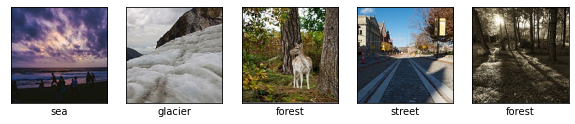

Sample image shape: (150, 150, 3)
RGB Color of center pixel: [183. 180. 173.]
Sample image shape: (150, 150, 3)
RGB Color of center pixel: [254. 254. 255.]
Sample image shape: (150, 150, 3)
RGB Color of center pixel: [12. 15. 22.]
Sample image shape: (150, 150, 3)
RGB Color of center pixel: [106. 108. 105.]
Sample image shape: (150, 150, 3)
RGB Color of center pixel: [221. 222. 208.]


In [7]:
# Get 5 random images, display their data shapes 
# and find the RGB color values for 75x75 pixel for them
indexes = show_random_images(categories, train_jpgs[30:150], train_labels[30:150], None, 5)
count =0
indexes.reverse()
for index in indexes:
    count += 1
    print("Sample image shape:", train_jpgs[index].shape)
    print("RGB Color of center pixel:", train_jpgs[index][75][75]*255)

In [8]:
print ("Training sample count: {}".format(train_labels.shape[0]))
print ("Testing sample count: {}".format(test_labels.shape[0]))

_, train_count = np.unique(train_labels, return_counts=True)
_, test_count = np.unique(test_labels, return_counts=True)

df = pd.DataFrame({'Train': train_count, 'Test': test_count}, index=categories)


Training sample count: 14034
Testing sample count: 3000


(array([0, 1, 2, 3, 4, 5]),
 [Text(0, 0, 'mountain'),
  Text(1, 0, 'street'),
  Text(2, 0, 'glacier'),
  Text(3, 0, 'buildings'),
  Text(4, 0, 'sea'),
  Text(5, 0, 'forest')])

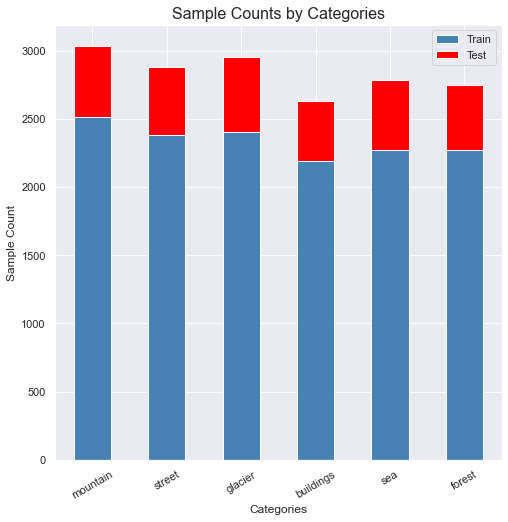

In [9]:
sns.set(style='white')
sns.set(rc={'figure.figsize':(8,8)})

df.plot(kind='bar', stacked=True, color=['steelblue', 'red'])

plt.title('Sample Counts by Categories', fontsize=16)

plt.xlabel('Categories')
plt.ylabel('Sample Count')
plt.xticks(rotation=30)

In [10]:
df['Total'] = df['Train']+df['Test']
df['Percent'] = df.Total/df.Total.sum()*100
df

,Train,Test,Total,Percent
mountain,2512,525,3037,17.829048
street,2382,501,2883,16.924974
glacier,2404,553,2957,17.359399
buildings,2191,437,2628,15.427968
sea,2274,510,2784,16.343783
forest,2271,474,2745,16.114829


(array([0, 1, 2, 3, 4, 5]),
 [Text(0, 0, 'mountain'),
  Text(1, 0, 'street'),
  Text(2, 0, 'glacier'),
  Text(3, 0, 'buildings'),
  Text(4, 0, 'sea'),
  Text(5, 0, 'forest')])

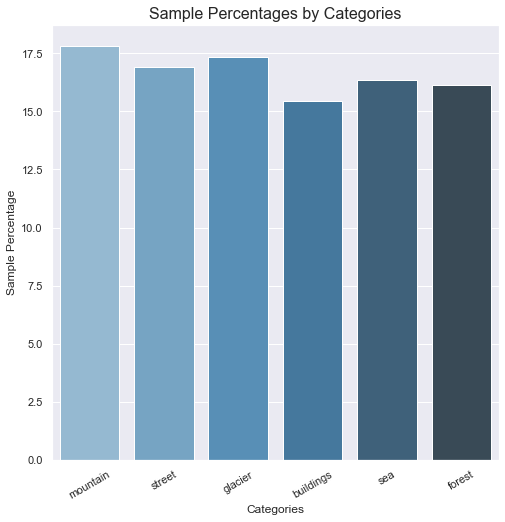

In [34]:
sns.set(style='white')
sns.set(rc={'figure.figsize':(8,8)})

sns.barplot(x=categories,y=df.Percent, data=df, palette="Blues_d")
plt.title('Sample Percentages by Categories', fontsize=16)

plt.xlabel('Categories')
plt.ylabel('Sample Percentage')
plt.xticks(rotation=30)

In [50]:
model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(32, (3, 3), activation = 'relu', input_shape = (150, 150, 3)), 
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Dropout(rate=0.2),
    tf.keras.layers.Conv2D(64, (3, 3), activation = 'relu'),
    tf.keras.layers.MaxPooling2D(2,2),
    tf.keras.layers.Dropout(rate=0.2),
    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dropout(rate=0.2),
    tf.keras.layers.Dense(64, activation='relu'),
    tf.keras.layers.Dropout(rate=0.2),
    tf.keras.layers.Dense(6, activation='softmax')
])

In [51]:
model.compile(optimizer = 'adam', loss = 'sparse_categorical_crossentropy', metrics=['accuracy'])
es = tf.keras.callbacks.EarlyStopping(monitor='val_loss', mode='auto', verbose=1, patience = 2)

In [52]:
fitted_model = model.fit(train_jpgs, train_labels, batch_size=128, epochs=15, validation_split = 0.2, callbacks=[es])

Epoch 1/15
88/88 [==============================] - 212s 2s/step - loss: 1.7018 - accuracy: 0.3997 - val_loss: 1.1316 - val_accuracy: 0.5921
Epoch 2/15
88/88 [==============================] - 268s 3s/step - loss: 1.0498 - accuracy: 0.6008 - val_loss: 0.9166 - val_accuracy: 0.6737
Epoch 3/15
88/88 [==============================] - 218s 2s/step - loss: 0.9118 - accuracy: 0.6585 - val_loss: 0.8296 - val_accuracy: 0.7093
Epoch 4/15
88/88 [==============================] - 210s 2s/step - loss: 0.7703 - accuracy: 0.7200 - val_loss: 0.7301 - val_accuracy: 0.7510
Epoch 5/15
88/88 [==============================] - 220s 2s/step - loss: 0.6459 - accuracy: 0.7626 - val_loss: 0.6924 - val_accuracy: 0.7592
Epoch 6/15
88/88 [==============================] - 217s 2s/step - loss: 0.5695 - accuracy: 0.7960 - val_loss: 0.6462 - val_accuracy: 0.7720
Epoch 7/15
88/88 [==============================] - 200s 2s/step - loss: 0.4793 - accuracy: 0.8273 - val_loss: 0.6540 - val_accuracy: 0.7691
Epoch 8/15
88

In [53]:
def plot_accuracy_loss(fitted_model):
    
    fig = plt.figure(figsize=(20,10))

    plt.subplot(221)
    plt.plot(fitted_model.history['accuracy'], label = "accuracy")
    plt.plot(fitted_model.history['val_accuracy'], label = "val_accuracy")
    plt.title("Train Accuracy vs Valication Accuracy")
    plt.ylabel("Accuracy")
    plt.xlabel("Number of Epochs")
    plt.legend()

    
    plt.subplot(222)
    plt.plot(fitted_model.history['loss'], label = "loss")
    plt.plot(fitted_model.history['val_loss'], label = "val_loss")
    plt.title("Train Loss vs Validation Loss")
    plt.ylabel("Loss")
    plt.xlabel("Number of Epochs")

    plt.legend()
    plt.show()

In [54]:
fitted_model.history

{'loss': [1.701804280281067,
  1.0497874021530151,
  0.911839485168457,
  0.7703108191490173,
  0.6459314823150635,
  0.5694658756256104,
  0.47929829359054565,
  0.40034064650535583,
  0.3609524369239807,
  0.3054032325744629],
 'accuracy': [0.3996615409851074,
  0.6007838249206543,
  0.6585018038749695,
  0.7199608087539673,
  0.7626258134841919,
  0.796027421951294,
  0.8272913694381714,
  0.8617618083953857,
  0.8722721934318542,
  0.8948962092399597],
 'val_loss': [1.1316157579421997,
  0.9165747165679932,
  0.8296360969543457,
  0.7301346063613892,
  0.6924017071723938,
  0.6462402939796448,
  0.6540078520774841,
  0.6373578310012817,
  0.6408106088638306,
  0.6695501804351807],
 'val_accuracy': [0.5920912027359009,
  0.6736729741096497,
  0.7092981934547424,
  0.7509797215461731,
  0.7591735124588013,
  0.7719985842704773,
  0.7691485285758972,
  0.7890986800193787,
  0.7862486839294434,
  0.7833986282348633]}

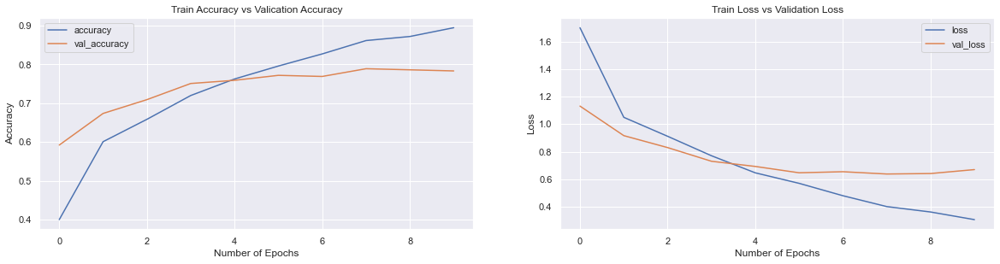

In [55]:
plot_accuracy_loss(fitted_model)

In [56]:
test_loss = model.evaluate(test_jpgs, test_labels)

94/94 [==============================] - 11s 113ms/step - loss: 0.6761 - accuracy: 0.7883


In [57]:
preds = model.predict(test_jpgs)     
pred_labels = np.argmax(preds, axis = 1)

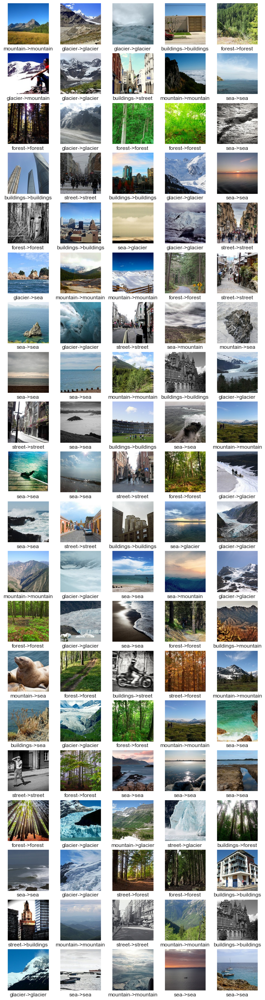

[2056,
 965,
 1280,
 838,
 395,
 2287,
 961,
 1765,
 2222,
 2813,
 243,
 919,
 172,
 254,
 2979,
 627,
 1598,
 692,
 1319,
 2648,
 195,
 494,
 1421,
 974,
 1718,
 2711,
 2134,
 2315,
 253,
 1824,
 2527,
 1394,
 1917,
 2143,
 2925,
 2790,
 2841,
 2436,
 647,
 981,
 1816,
 2983,
 551,
 2823,
 2256,
 2562,
 2681,
 1897,
 176,
 956,
 2794,
 1567,
 850,
 1218,
 1311,
 2392,
 1379,
 2815,
 2247,
 1020,
 440,
 1328,
 2991,
 284,
 2400,
 2995,
 0,
 1880,
 319,
 2313,
 2766,
 1332,
 272,
 2256,
 2975,
 1905,
 411,
 2747,
 2501,
 2965,
 335,
 1003,
 990,
 1331,
 448,
 2547,
 1462,
 165,
 174,
 560,
 624,
 2244,
 1940,
 2442,
 647,
 1013,
 2922,
 2180,
 2538,
 2999]

In [58]:
show_random_images(categories, test_jpgs, pred_labels, test_labels, 100)

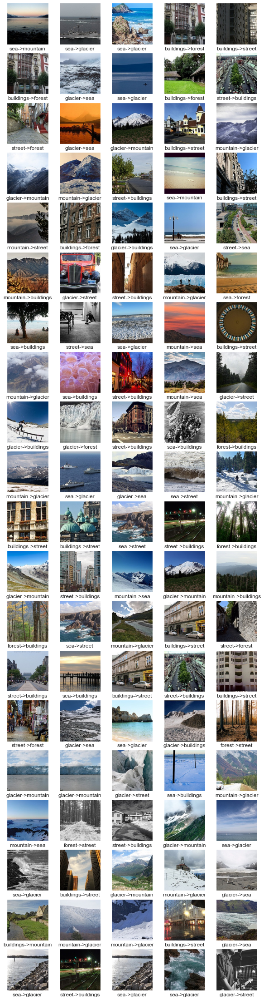

In [59]:
show_miscategorized_images(categories, test_jpgs, test_labels, pred_labels, 100)

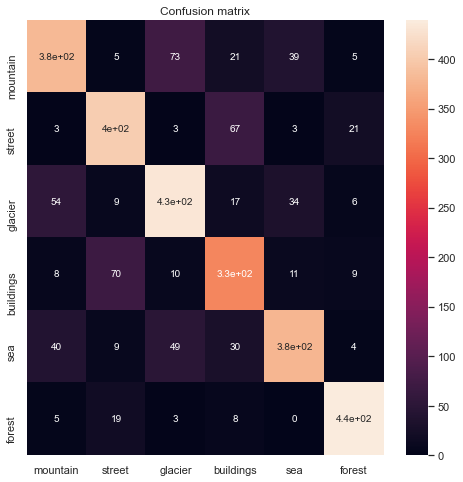

In [60]:
CM = confusion_matrix(test_labels, pred_labels)
ax = plt.axes()
sns.heatmap(CM, annot=True, 
           annot_kws={"size": 10}, 
           xticklabels=categories, 
           yticklabels=categories, ax = ax)
ax.set_title('Confusion matrix')
plt.show()

In [65]:
test_pred = []
for i in range(len(test_labels)):
    if test_labels[i]!=pred_labels[i]:
        test_pred.append(categories[test_labels[i]]+"->"+categories[pred_labels[i]])

dfx = pd.DataFrame(np.array(test_pred), columns=['test_pred'])
dfx = dfx.groupby('test_pred').size().to_frame('size')
dfx.sort_values('size', ascending=False)

,size
test_pred,
mountain->glacier,73
buildings->street,70
street->buildings,67
glacier->mountain,54
sea->glacier,49
sea->mountain,40
mountain->sea,39
glacier->sea,34
sea->buildings,30


In [62]:
pred_jpgs = []
pred_img_path = './archive/seg_pred/seg_pred'
count=0
for file in os.listdir(pred_img_path):
    if file.endswith('.jpg') and count<=5000:
        count += 1
        image = cv2.imread(os.path.join(pred_img_path, file))
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        image = cv2.resize(image,img_size)
        pred_jpgs.append(image)

pred_jpgs = np.array(pred_jpgs, dtype = 'float32') / 255.0
preds = model.predict(pred_jpgs)     
preds_labels = np.argmax(preds, axis = 1)


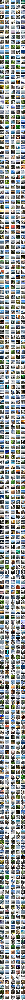

[1027,
 3887,
 2471,
 2010,
 4028,
 4343,
 4172,
 1780,
 2206,
 361,
 4574,
 4152,
 580,
 26,
 3034,
 1655,
 1830,
 3467,
 2916,
 3583,
 4856,
 659,
 4599,
 1144,
 1385,
 3527,
 1865,
 4676,
 3367,
 4738,
 3919,
 2256,
 2981,
 3476,
 1145,
 1765,
 4834,
 2849,
 2225,
 4181,
 239,
 2809,
 4233,
 3468,
 3398,
 1248,
 4483,
 3314,
 4716,
 1613,
 1104,
 4580,
 3799,
 3353,
 1123,
 3116,
 331,
 1222,
 1469,
 1476,
 530,
 2035,
 377,
 4876,
 3774,
 2834,
 2741,
 3209,
 2446,
 3973,
 4732,
 2842,
 2149,
 272,
 1574,
 4013,
 3110,
 3884,
 2321,
 954,
 3155,
 395,
 4100,
 2007,
 1922,
 3042,
 1917,
 1045,
 617,
 3585,
 1833,
 4872,
 3553,
 1881,
 2814,
 791,
 1458,
 737,
 3904,
 3140,
 3816,
 1286,
 639,
 807,
 3649,
 604,
 1554,
 3802,
 1730,
 4547,
 51,
 678,
 3813,
 3445,
 4388,
 4087,
 2544,
 3154,
 450,
 491,
 4541,
 934,
 820,
 1779,
 433,
 1300,
 1918,
 2214,
 2665,
 351,
 1549,
 1577,
 4993,
 1872,
 2565,
 3707,
 144,
 1894,
 1970,
 4738,
 4335,
 1397,
 827,
 3441,
 3576,
 4415,
 3010,


In [63]:
show_random_images(categories, pred_jpgs, preds_labels, None, 1000)

In [64]:
# Save model to file
model_json = model.to_json()
with open("model.json", "w") as json_file:
    json_file.write(model_json)

model.save_weights("model.h5")
print("Saved model to disk")
 
# Load model from file
json_file = open('model.json', 'r')
loaded_model_json = json_file.read()
json_file.close()
loaded_model = tf.keras.models.model_from_json(loaded_model_json)
loaded_model.load_weights("model.h5")
print("Loaded model from disk")

Saved model to disk
Loaded model from disk
